# Phase #3 Data Mining - Classification & Clustering

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler

In [ ]:
df=pd.read_csv("Proccessed_dataset.csv")

drop the ID column

In [ ]:
x=list(df.keys())[1:]
df2=df[x]
print (df2)

      PetType       AgeMonths   Color  Size  WeightKg  Vaccinated  \
0           0  121-180 months  Orange     0  0.138783           1   
1           3   61-120 months   White     0  0.520009           0   
2           2  121-180 months  Orange     1  0.036514           0   
3           0   61-120 months   White     2  0.080105           0   
4           3  121-180 months    Gray     0  0.672244           0   
...       ...             ...     ...   ...       ...         ...   
2002        2   61-120 months  Orange     2  0.897969           1   
2003        3  121-180 months   Brown     2  0.127988           1   
2004        3   61-120 months  Orange     2  0.025551           1   
2005        2     7-12 months    Gray     0  0.688239           1   
2006        3  121-180 months   White     1  0.603973           1   

      HealthCondition TimeInShelterDays  AdoptionFee  PreviousOwner  \
0                   0        Short Stay     0.280561              0   
1                   0   Very 

# Classification

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier,plot_tree
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn import tree
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree

In [ ]:
#split dataset in features and target variable
fn=df2.keys().tolist()[:-1]
X=df2[fn]
y=df2['AdoptionLikelihood']

In [ ]:
from sklearn.preprocessing import LabelEncoder
encoder =LabelEncoder()
for col in X.select_dtypes('object').columns:
   X.loc[:,col]=encoder.fit_transform(X[col])

In [ ]:
 # Split data for the partition size
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

# Initialize classifiers with both Gini and Entropy criteria
dt_gini = DecisionTreeClassifier(criterion='gini', random_state=1)
dt_entropy = DecisionTreeClassifier(criterion='entropy', random_state=1)


 **Partition:  20.0 Test - 80.0  Train**




**Gini Index:**

In [ ]:
# Train and evaluate with Gini index
clf=dt_gini.fit(X_train, y_train)
y_pred_gini = dt_gini.predict(X_test)
accuracy_gini = accuracy_score(y_test, y_pred_gini)
# Error Rate
error_rate = 1 - accuracy_gini
cm_gini = confusion_matrix(y_test, y_pred_gini)
# Sensitivity (Recall) and Specificity  require TN, FP, FN, TP :
TP = cm_gini[1, 1]
TN = cm_gini[0, 0]
FP = cm_gini[0, 1]
FN = cm_gini[1, 0]
# Sensitivity (Recall )
sensitivity = TP / (TP + FN)
# Specificity
specificity = TN / (TN + FP)
# Precision
precision = TP / (TP + FP)

In [ ]:
print("Gini Index:")
print("Accuracy:",accuracy_gini)
print("Error Rate:", error_rate)
print("Sensitivity:", sensitivity)
print("Specificity:", specificity)
print("Precision:", precision)

Gini Index:
Accuracy: 0.7786069651741293
Error Rate: 0.2213930348258707
Sensitivity: 0.6885245901639344
Specificity: 0.8178571428571428
Precision: 0.6222222222222222


The decision tree model, built using the Gini Index as the splitting criterion, achieved an accuracy of 77.86%, indicating that it correctly classified   77.86% of the data. However, the model has some limitations as reflected in the following metrics:

Error Rate: 22.14%

About 22% of predictions were incorrect.
Sensitivity (Recall for Positive Class): 68.85%

The model identified 68.85% of the actual positive cases, showing a moderate ability to detect positives. This leaves a notable number of false negatives.
Specificity (Recall for Negative Class): 81.79%

The model successfully recognized 81.79% of negative cases, indicating better performance in detecting negatives and fewer false positives.
Precision (Positive Predictive Value): 62.22%

Among the cases predicted as positive, only 62.22% were actually positive, reflecting a relatively high number of false positives.

**confusion matrix:**

Confusion Matrix:
 [[229  51]
 [ 38  84]]


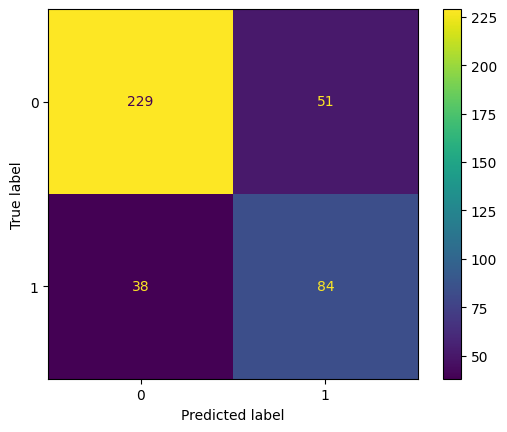

In [ ]:
print("Confusion Matrix:\n", cm_gini)
cn=df2['AdoptionLikelihood'].unique()
disp=ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, display_labels=cn)

The confusion matrix represents the performance measurement of the classification model. In this case, we have a 2x2 confusion matrix where each row represents the actual classification, and each column represents the predicted classification. From the results, it appears:

The top-left cell: (229) represents the number of instances of the negative class correctly classified as negative (TN).

The top-right cell: (51) represents the number of instances of the negative class incorrectly classified as positive (FP).

The bottom-left cell: (38) represents the number of instances of the positive class incorrectly classified as negative (FN).
The bottom-right cell: (84) represents the number of instances of the positive class correctly classified as positive (TP).

In [ ]:
# Plot the decision tree Gini Index
plt.figure(figsize=(15, 15), dpi=600)
class_names = df2['AdoptionLikelihood'].astype(str).unique()
plot_tree(clf, filled=True, feature_names=fn, class_names=class_names)
plt.title("Decision Tree Gini Index")
plt.show()

In this tree, the splitting process begins with the criterion of Vaccinated, where samples are segregated based on their Vaccinated values. The selection of features at each node is determined by their Gini Index.
Following the split on Vaccinated, the tree considers the AgeMonths, dividing samples accordingly. Subsequently, HealthCondition  is examined, leading to further division of samples.
This splitting procedure persists for each attribute, guided by their respective values at each level, until reaching the leaf nodes. These leaf nodes act as terminal points, providing the final classification (whether it likely adopted or Unlikely) based on the path followed through the tree.

In [ ]:
# Train and evaluate with Entropy (Information Gain)
clf=dt_entropy.fit(X_train, y_train)
y_pred_entropy = dt_entropy.predict(X_test)
accuracy_entropy = accuracy_score(y_test, y_pred_entropy)
# Error Rate
error_rate = 1 - accuracy_entropy
cm_entropy = confusion_matrix(y_test, y_pred_entropy)
# Sensitivity (Recall) and Specificity  require TN, FP, FN, TP :
TP = cm_entropy[1, 1]
TN = cm_entropy[0, 0]
FP = cm_entropy[0, 1]
FN = cm_entropy[1, 0]
# Sensitivity (Recall )
sensitivity = TP / (TP + FN)
# Specificity
specificity = TN / (TN + FP)
# Precision
precision = TP / (TP + FP)
print("Entropy (Information Gain):")
print("Accuracy: ",accuracy_entropy)
print("Error Rate:", error_rate)
print("Sensitivity:", sensitivity)
print("Specificity:", specificity)
print("Precision:", precision)

Entropy (Information Gain):
Accuracy:  0.7910447761194029
Error Rate: 0.20895522388059706
Sensitivity: 0.7049180327868853
Specificity: 0.8285714285714286
Precision: 0.6417910447761194


The model achieved an accuracy of 79.10%, meaning it correctly classified about 79% of the data. Compared to the Gini Index-based tree, the Entropy-based model performs slightly better, particularly in terms of accuracy, sensitivity, and precision.

Accuracy:This indicates the model correctly predicted outcomes for79.10% cases.

Error Rate:  20.90% of predictions were incorrect, which is slightly better than the Gini Index model.

Sensitivity (Recall for Positive Class): The model detected around 70% of actual positive cases, which is an improvement over the Gini Index model. However, it still struggles with false negatives.

Specificity (Recall for Negative Class): The model successfully identified about 82.86% of negative cases, performing slightly better than the Gini Index model at avoiding false positives.

Precision (Positive Predictive Value):
Among the cases predicted as positive, 64.18% were actually positive, representing an improvement in handling false positives compared to the Gini Index

Confusion Matrix:
 [[232  48]
 [ 36  86]]


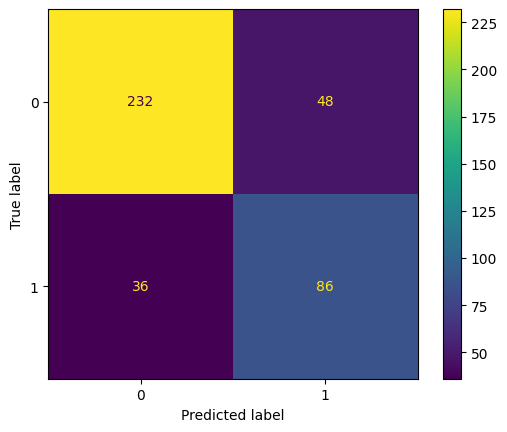

In [ ]:
print("Confusion Matrix:\n", cm_entropy)
cn=df2['AdoptionLikelihood'].unique()
disp=ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, display_labels=cn)

As we shown we used confusion matrix to summarizes the basic measures for performance evaluation This matrix is a 2x2 array where:

-(232) is true negatives (TN) means actual negatives correctly identified by the model.

-(48) is false positives (FP) means actual negatives incorrectly identified as positives.

-(36) is false negatives (FN) means actual positives incorrectly identified as negatives.

-(86) is true positives (TP) means actual positives correctly identified by the model.


In [ ]:
# Plot the decision Entropy tree
plt.figure(figsize=(15, 15), dpi=600)
class_names = df2['AdoptionLikelihood'].astype(str).unique()
plot_tree(clf, filled=True, feature_names=fn, class_names=class_names)
plt.title("Decision Tree Entropy")
plt.show()

As we shown the tree starts with the root node in this data is “Vaccinated” This means the tree branches out from the root node based on the 'Vaccinated' value , The tree makes several splits based on the feature values, and these are represented by the decision nodes. The features at each node are selected based on entropy .

And also we have leaf Node this is the terminal nodes that provide the final classification based on the path taken through the tree.A leaf node will also provide the class label ('1' or '0')


 **Partition:  30.0 Test - 70.0  Train**




In [ ]:
 X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=1)

In [ ]:
# Train and evaluate with Gini index
clf=dt_gini.fit(X_train, y_train)
y_pred_gini = dt_gini.predict(X_test)
accuracy_gini = accuracy_score(y_test, y_pred_gini)
# Error Rate
error_rate = 1 - accuracy_gini
cm_gini = confusion_matrix(y_test, y_pred_gini)
# Sensitivity (Recall) and Specificity  require TN, FP, FN, TP :
TP = cm_gini[1, 1]
TN = cm_gini[0, 0]
FP = cm_gini[0, 1]
FN = cm_gini[1, 0]
# Sensitivity (Recall )
sensitivity = TP / (TP + FN)
# Specificity
specificity = TN / (TN + FP)
# Precision
precision = TP / (TP + FP)
print("Gini Index:")
print("Accuracy:",accuracy_gini)
print("Error Rate:", error_rate)
print("Sensitivity:", sensitivity)
print("Specificity:", specificity)
print("Precision:", precision)

Gini Index:
Accuracy: 0.7976782752902156
Error Rate: 0.20232172470978438
Sensitivity: 0.7046632124352331
Specificity: 0.8414634146341463
Precision: 0.6766169154228856


The decision tree achieved an accuracy of 79.77%, meaning it correctly classified 79.77% cases. Compared to the earlier Gini Index-based model, there is an improvement in accuracy, specificity, and precision, indicating better overall performance.

**Accuracy**:
The model correctly predicted outcomes for almost 79.77% of the data, showing good reliability.

**Error Rate**: About 20.23% of predictions were incorrect, which is slightly lower than the previous Gini Index model's error rate.

**Sensitivity** (Recall for Positive Class):
The model identified 70.47% of true positive cases, it still struggles with false negatives, as almost 30% of positive cases are missed.

**Specificity** (Recall for Negative Class):
The model successfully recognized 84.15% of negative cases, reflecting a stronger ability to avoid false positives compared to earlier models.

**Precision** (Positive Predictive Value):
Among cases predicted as positive, 67.66% were correct, which is a significant improvement over the earlier Gini Index model. This suggests better handling of false positives.

Confusion Matrix:
 [[345  65]
 [ 57 136]]


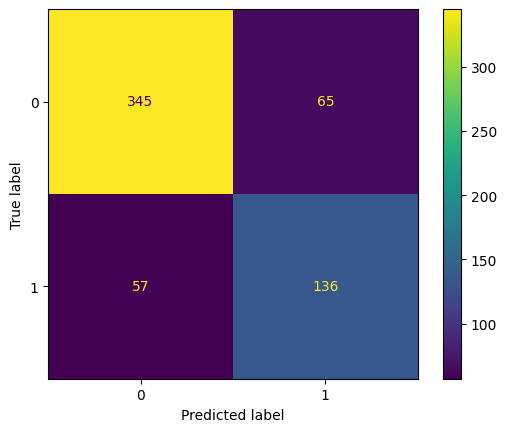

In [ ]:
print("Confusion Matrix:\n", cm_gini)
cn=df2['AdoptionLikelihood'].unique()
disp=ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, display_labels=cn)

As we shown we used confusion matrix to summarizes the basic measures for performance evaluation This matrix is a 2x2 array where:

-(345) is true negatives (TN) means actual negatives correctly identified by the model.

-(65) is false positives (FP) means actual negatives incorrectly identified as positives.

-(57) is false negatives (FN) means actual positives incorrectly identified as negatives.

-(136) is true positives (TP) means actual positives correctly identified by the model.

In [ ]:
# Plot the decision tree Gini Index
plt.figure(figsize=(15, 15), dpi=600)
class_names = df2['AdoptionLikelihood'].astype(str).unique()
plot_tree(clf, filled=True, feature_names=fn, class_names=class_names)
plt.title("Decision Tree Gini Index")
plt.show()

The decision tree model for predicting pet being adopted  (Vaccinated) as the initial splitting criterion. If Vaccinated is less than or equal to 0.5, the model further splits the data based on features such as size, HealthCondition, AgeMonths, and others. The terminal nodes (leaf nodes) in the decision tree provide the final predicted outcome or class label, where class 1 represents pet likely being adopted class 2 represents Unlikely

In [ ]:
# Train and evaluate with Entropy (Information Gain)
clf=dt_entropy.fit(X_train, y_train)
y_pred_entropy = dt_entropy.predict(X_test)
accuracy_entropy = accuracy_score(y_test, y_pred_entropy)
# Error Rate
error_rate = 1 - accuracy_entropy
cm_entropy = confusion_matrix(y_test, y_pred_entropy)
# Sensitivity (Recall) and Specificity  require TN, FP, FN, TP :
TP = cm_entropy[1, 1]
TN = cm_entropy[0, 0]
FP = cm_entropy[0, 1]
FN = cm_entropy[1, 0]
# Sensitivity (Recall )
sensitivity = TP / (TP + FN)
# Specificity
specificity = TN / (TN + FP)
# Precision
precision = TP / (TP + FP)
print("Entropy (Information Gain):")
print("Accuracy: ",accuracy_entropy)
print("Error Rate:", error_rate)
print("Sensitivity:", sensitivity)
print("Specificity:", specificity)
print("Precision:", precision)

Entropy (Information Gain):
Accuracy:  0.8258706467661692
Error Rate: 0.17412935323383083
Sensitivity: 0.7305699481865285
Specificity: 0.8707317073170732
Precision: 0.7268041237113402


The decision tree achieved an accuracy of 82.59%, meaning it correctly classified over 82% of cases. This indicates an improvement compared to the previous models, particularly in terms of overall accuracy, sensitivity, and specificity. The model effectively balances the ability to detect positive cases and avoid false positives.

**Accuracy**:
The model correctly predicted 82.59% of the outcomes, showcasing the best accuracy among all models tested so far.

**Error Rate**:
Only about 17% of predictions were incorrect, indicating strong predictive performance.

**Sensitivity** (Recall for Positive Class):
The model identified 73.06% of true positive cases, an improvement over both Gini Index-based models. It handles false negatives better, making it more effective at identifying positive cases.

**Specificity** (Recall for Negative Class):
The model successfully identified 87.07% of negative cases, demonstrating excellent performance in avoiding false positives.

**Precision** (Positive Predictive Value):
Among all cases predicted as positive, 72.68% were actually correct, reflecting a reliable balance between sensitivity and precision.

Confusion Matrix:
 [[357  53]
 [ 52 141]]


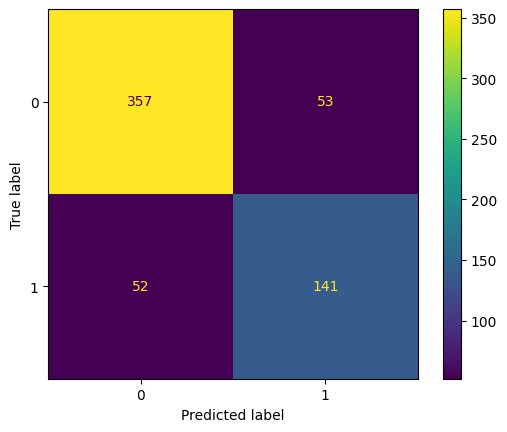

In [ ]:
print("Confusion Matrix:\n", cm_entropy)
cn=df2['AdoptionLikelihood'].unique()
disp=ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, display_labels=cn)

As we shown we used confusion matrix to summarizes the basic measures for performance evaluation This matrix is a 2x2 array where:

-(357) is true negatives (TN) means actual negatives correctly identified by the model.

-(53) is false positives (FP) means actual negatives incorrectly identified as positives.

-(52) is false negatives (FN) means actual positives incorrectly identified as negatives.

-(141) is true positives (TP) means actual positives correctly identified by the model.

In [ ]:
# Plot the decision Entropy tree
plt.figure(figsize=(15, 15), dpi=600)
class_names = df2['AdoptionLikelihood'].astype(str).unique()
plot_tree(clf, filled=True, feature_names=fn, class_names=class_names)
plt.title("Decision Tree Entropy")
plt.show()

In this tree, the splitting process begins with the criterion of Vaccinated , where samples are segregated based on their Vaccinated values. The selection of features at each node is determined by their entropy values.
Following the split on Vaccinated, the tree considers the size , dividing samples accordingly. Subsequently, the PetType is examined, leading to further division of samples.
This splitting procedure persists for each attribute, guided by their respective values at each level, until reaching the leaf nodes. These leaf nodes act as terminal points, providing the final classification whether it likely adopted or Unlikely, based on the path followed through the tree.


 **Partition:  40.0 Test - 60.0  Train**




In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=1)

In [ ]:
# Train and evaluate with Gini index
clf=dt_gini.fit(X_train, y_train)
y_pred_gini = dt_gini.predict(X_test)
accuracy_gini = accuracy_score(y_test, y_pred_gini)
# Error Rate
error_rate = 1 - accuracy_gini
cm_gini = confusion_matrix(y_test, y_pred_gini)
# Sensitivity (Recall) and Specificity  require TN, FP, FN, TP :
TP = cm_gini[1, 1]
TN = cm_gini[0, 0]
FP = cm_gini[0, 1]
FN = cm_gini[1, 0]
# Sensitivity (Recall )
sensitivity = TP / (TP + FN)
# Specificity
specificity = TN / (TN + FP)
# Precision
precision = TP / (TP + FP)
print("Gini Index:")
print("Accuracy:",accuracy_gini)
print("Error Rate:", error_rate)
print("Sensitivity:", sensitivity)
print("Specificity:", specificity)
print("Precision:", precision)

Gini Index:
Accuracy: 0.8144458281444583
Error Rate: 0.18555417185554168
Sensitivity: 0.7423076923076923
Specificity: 0.848987108655617
Precision: 0.7018181818181818


The decision tree, using the Gini Index, achieved an accuracy of 81.44%, meaning it correctly classified approximately 81% of the data. This version of the Gini Index model shows an improvement in sensitivity, precision, and overall performance when compared to earlier Gini models.


**Accuracy**:
The model correctly predicted about 81.44% of the outcomes, showcasing strong predictive accuracy, with only a modest error rate.

**Error Rate**:
The error rate is 18.56%, indicating that about 19% of predictions were incorrect. While this is an improvement over some earlier versions, there’s still room for enhancement.

**Sensitivity** (Recall for Positive Class):
The model identified 74.23% of true positive cases, improving on previous Gini-based models and showing a stronger ability to capture positive cases while reducing false negatives.

**Specificity** (Recall for Negative Class):
The model correctly identified 84.90% of negative cases, which demonstrates solid performance in avoiding false positives.

**Precision** (Positive Predictive Value):
Among the cases predicted as positive, 70.18% were correctly classified as positive, reflecting a strong ability to make accurate positive predictions and reducing false positives.

Confusion Matrix:
 [[461  82]
 [ 67 193]]


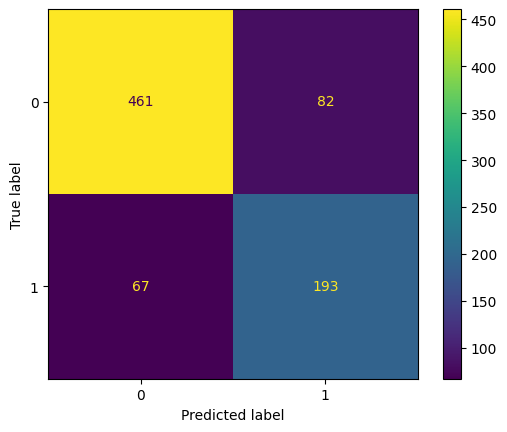

In [ ]:
print("Confusion Matrix:\n", cm_gini)
cn=df2['AdoptionLikelihood'].unique()
disp=ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, display_labels=cn)

As we shown we used confusion matrix to summarizes the basic measures for performance evaluation This matrix is a 2x2 array where:

-(461) is true negatives (TN) means actual negatives correctly identified by the model.

-(82) is false positives (FP) means actual negatives incorrectly identified as positives.

-(67) is false negatives (FN) means actual positives incorrectly identified as negatives.

-(193) is true positives (TP) means actual positives correctly identified by the model.

In [ ]:
# Plot the decision tree Gini Index
plt.figure(figsize=(15, 15), dpi=600)
class_names = df2['AdoptionLikelihood'].astype(str).unique()
plot_tree(clf, filled=True, feature_names=fn, class_names=class_names)
plt.title("Decision Tree Gini Index")
plt.show()

As we shown the tree starts with the root node in this data is “Vaccinated” This means the tree branches out from the root node based on the 'Vaccinated' value , The tree makes several splits based on the feature values, and these are represented by the decision nodes. The features at each node are selected based on Gini Index . And also we have leaf Node this is the terminal nodes that provide the final classification based on the path taken through the tree.A leaf node will also provide the class label ('1' or '0')

In [ ]:
# Train and evaluate with Entropy (Information Gain)
clf=dt_entropy.fit(X_train, y_train)
y_pred_entropy = dt_entropy.predict(X_test)
accuracy_entropy = accuracy_score(y_test, y_pred_entropy)
# Error Rate
error_rate = 1 - accuracy_entropy
cm_entropy = confusion_matrix(y_test, y_pred_entropy)
# Sensitivity (Recall) and Specificity  require TN, FP, FN, TP :
TP = cm_entropy[1, 1]
TN = cm_entropy[0, 0]
FP = cm_entropy[0, 1]
FN = cm_entropy[1, 0]
# Sensitivity (Recall )
sensitivity = TP / (TP + FN)
# Specificity
specificity = TN / (TN + FP)
# Precision
precision = TP / (TP + FP)
print("Entropy (Information Gain):")
print("Accuracy: ",accuracy_entropy)
print("Error Rate:", error_rate)
print("Sensitivity:", sensitivity)
print("Specificity:", specificity)
print("Precision:", precision)

Entropy (Information Gain):
Accuracy:  0.8293897882938979
Error Rate: 0.17061021170610213
Sensitivity: 0.7538461538461538
Specificity: 0.8655616942909761
Precision: 0.7286245353159851


The Entropy-based model achieved an accuracy of 82.94%, meaning it correctly classified approximately 83% of the data. This is the highest accuracy among all the models tested so far, indicating the model's strong predictive performance. It also demonstrates solid performance in terms of sensitivity, specificity, and precision, showing a balanced approach to classification.

**Accuracy**:
The model correctly predicted 82.94% of the outcomes, achieving the highest accuracy compared to the other models (including those based on the Gini Index). This demonstrates excellent overall performance.

**Error Rate**:
The error rate is 17.06%, indicating that about 17% of predictions were incorrect. Given the high accuracy, this is a relatively low error rate, confirming the model’s robustness.

**Sensitivity** (Recall for Positive Class):
The model identified 75.38% of the actual positive cases, making it particularly good at detecting positive instances. This represents an improvement in sensitivity over the previous models and reduces the false negatives.

**Specificity** (Recall for Negative Class):
The model correctly identified 86.56% of negative cases, showing strong performance in avoiding false positives. This is also an improvement over earlier models in terms of specificity.

**Precision** (Positive Predictive Value):
Among the cases predicted as positive, 72.86% were correctly identified, reflecting the model's strong precision and ability to reduce false positives.

Confusion Matrix:
 [[470  73]
 [ 64 196]]


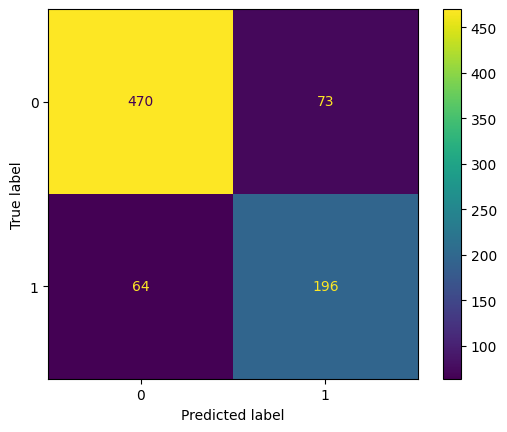

In [ ]:
print("Confusion Matrix:\n", cm_entropy)
cn=df2['AdoptionLikelihood'].unique()
disp=ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, display_labels=cn)

As we shown we used confusion matrix to summarizes the basic measures for performance evaluation This matrix is a 2x2 array where:

-(470) is true negatives (TN) means actual negatives correctly identified by the model.

-(73) is false positives (FP) means actual negatives incorrectly identified as positives.

-(64) is false negatives (FN) means actual positives incorrectly identified as negatives.

-(196) is true positives (TP) means actual positives correctly identified by the model.

In [ ]:
# Plot the decision Entropy tree
plt.figure(figsize=(20, 20), dpi=700)
class_names = df2['AdoptionLikelihood'].astype(str).unique()
plot_tree(clf, filled=True, feature_names=fn, class_names=class_names)
plt.title("Decision Tree Entropy")
plt.show()

The decision tree for predicting is built on the importance of Vaccinated and further splits on features such as size , HealthCondition, WeightKg, AdoptionFee, AgeMonths, and PetType. The tree's structure reveals complex decision pathways based on combinations of these features. Terminal nodes provide the final predicted outcome (1 for pet being Likely adopted, 2 for Unlikely  )based on the feature values and their importance. The depth and complexity of the decision tree demonstrate the diverse factors considered by the model in assessing Likelihood of the pet being adopted . Understanding the decision tree provides valuable insights into the model's inner workings and its ability to predict Likelihood of the pet being adopted

**Reasons for choosing partition**

**-Reasons for Using 80% Training and 20% Testing**

 • By allocating 80% of the dataset to training, the model has enough data to learn patterns and generalize well, particularly for larger datasets or complex models.

 • A 20% test set ensures the model’s performance is evaluated on a substantial and diverse set of unseen data, providing reliable insights into its generalization capabilities

 **-Reasons for Using 70% Training and 30% Testing**

 70% Training: Provides enough data for the model to learn patterns effectively, especially for larger datasets, without overwhelming the algorithm with too much data or overfitting to the training set.

 • 30% Testing: Ensures sufficient data is available to evaluate the model’s performance on unseen data, which gives a reliable indication of how the model will generalize in real-world scenarios.

**-Reasons for Using 60% Training and 40% Testing**

 The larger test set (40%) allows for a thorough and diverse evaluation of the model. In cases where the model needs to handle rare or edge cases, a bigger test set ensures that these scenarios are well-represented and the model’s robustness is properly assessed.
 2. Ensuring Reliable Performance Metrics
 • By having a substantial 40% of the data reserved for testing, I can ensure that the performance metrics (e.g., accuracy, precision, recall) are more reliable and reflective of how the model will perform in real-world situations.


# Comparison of Decision Tree Classifier Performance

We tested how well Decision Tree classifiers perform using two methods: Gini Index and Entropy . These tests were done with three different dataset splits: 20%, 30%, and 40% of the data for testing, while the rest was used for training.
 1. 20% Test - 80% Train

 • **Gini Index**:
  
   Accuracy: 0.7786

   Sensitivity:0.6885

   Specificity:0.8178

   Precision:0.6222

   Error Rate:0.2213
   

  • **Entropy:**
   
   Accuracy: 0.7910

   Sensitivity:0.7049

   Specificity:0.8285

   Precision:0.6417

   Error Rate:0.2089

 • Entropy performs slightly better than Gini in all metrics, showing higher accuracy, sensitivity, specificity, and precision. This suggests that for smaller test splits, Entropy captures the patterns in the data slightly better.


 2. 30% Test - 70% Train

 • **Gini Index**

   Accuracy: 0.7976

   Sensitivity:0.7046

   Specificity:0.8414

   Precision:0.6766

   Error Rate:0.2023

 • **Entropy**

   Accuracy: 0.8258

   Sensitivity:0.7305

   Specificity:0.8707

   Precision:0.7268

   Error Rate:0.1741

 • Entropy continues to outperform Gini by a significant margin in accuracy, sensitivity, specificity, and precision. The gap widens as the test split increases, indicating Entropy's strength in handling more diverse test data..

3. 40% Test - 60% Train

 • **Gini Index**

   Accuracy: 0.8144

   Sensitivity:0.7423

   Specificity:0.8489

   Precision:0.7018

   Error Rate:0.1855

 • **Entropy**

   Accuracy: 0.8293

   Sensitivity:0.7538

   Specificity:0.8655

   Precision:0.7286

   Error Rate:0.1706

 • Entropy still has a slight edge over Gini, especially in sensitivity and precision. However, the gap between the two becomes narrower with the larger test split.



**Conclusion:**

After comparing the performance metrics from the Gini Index and Entropy (Information Gain) tables, it is evident that the Entropy criterion with a 60% training set and 40% testing set provides the most consistent and optimal results across all key metrics. This setup achieves the highest accuracy (0.8293), specificity (0.8655), and precision (0.7286), while also having the lowest error rate (0.1706). This means that using Entropy as the criterion for Decision Tree classification is likely to give better results with this type of data.

# Clustering (results with low silhouette score )

Using all features absolutely except "class Label"

In [ ]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt


**Scaled Dataframe**

In [ ]:
features = df2.drop(columns=['AdoptionLikelihood'], axis=1)
scaler = StandardScaler()
scaled_features = scaler.fit_transform(features)
pet_scaled = pd.DataFrame(scaled_features , columns=features.columns)
print("Scaled DataFrame:")
print(pet_scaled)

ValueError: could not convert string to float: '121-180 months'

**Choosing the Number of Clusters K**


by evaluate the clustering results using both the Silhouette coefficient and the Elbow method.

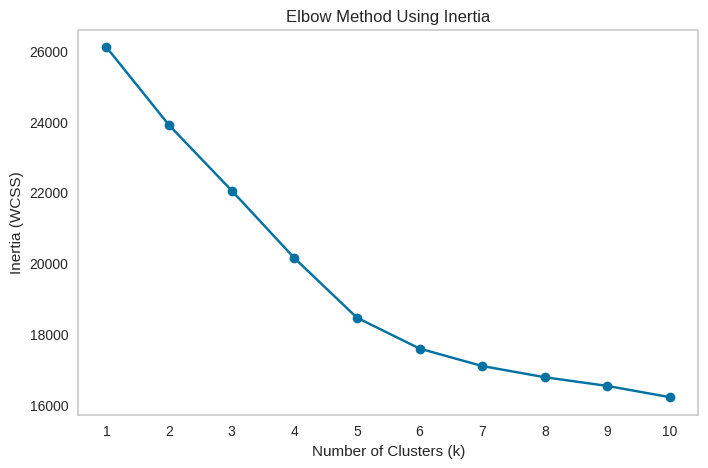

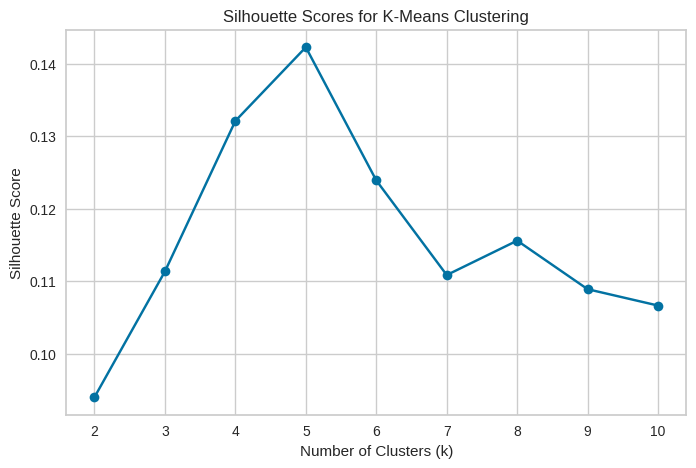

In [ ]:
from sklearn.metrics import silhouette_score
inertia_values = []
k_range = range(1, 11)  # Test for k from 1 to 10

for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(scaled_features)  # Use your normalized features
    inertia_values.append(kmeans.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(k_range, inertia_values, marker='o')
plt.title("Elbow Method Using Inertia")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Inertia (WCSS)")
plt.xticks(k_range)
plt.grid()
plt.show()



silhouette_scores = []
k_range = range(2, 11)  # Start from 2 clusters (k=1 is meaningless for silhouette)

for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(scaled_features)
    score = silhouette_score(scaled_features, labels)
    silhouette_scores.append(score)

plt.figure(figsize=(8, 5))
plt.plot(k_range, silhouette_scores, marker='o')
plt.title("Silhouette Scores for K-Means Clustering")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Silhouette Score")
plt.show()


Discussion & comparison
1.  **Elbow Method (Inertia vs Number of Clusters):**

The Elbow method looks at the total within-cluster sum of squares (inertia) and helps identify the point where adding more clusters does not significantly improve the fit.

From the results:

K=3: Inertia approximately  22000

K=4: Inertia decreases to approximately 20000

K=5: Inertia further reduces to approximately 18000

The inertia steadily decreases as the number of clusters K increases. This is expected since increasing K reduces the distance between data points and their cluster centers.
The rate of decrease slows noticeably after  K=5. This suggests that adding more clusters beyond  K=5  does not significantly improve the compactness of the clusters.


2. **Silhouette Score vs Number of Clusters:**
The Silhouette coefficient measures how similar an object is to its own cluster compared to other clusters. A higher score indicates better-defined clusters.

The silhouette score peaks at  K=5 , indicating that the clusters are best separated at this point.
- For  K=4  and  K=6 , the silhouette score is lower, showing less well-defined clusters. Beyond  K=5, the score decreases significantly, indicating that the additional clusters result in worse separation or overly fragmented clusters.


**Conclusion:**
1. **Optimal K **: Based on the silhouette score,  K=5 is the most suitable choice, as it provides the highest score, indicating well-defined and separated clusters.
2. **Support from the Elbow Method**:the inertia plot supports  K=5  as a reasonable point where the rate of inertia reduction begins to slow.

The combination of the Elbow method and the Silhouette coefficient suggests that
K=5 is the best choice. It balances the compactness (inertia) of the clusters with their separation(silhouette score), ensuring that the clusters are well-defined without unnecessary complexity.
 K=5  is the optimal number of clusters, balancing compactness (inertia) and separation (silhouette score).






**#Validation & evaluation of Clusters with Silhouette Score**

The average silhouette score is: 0.1422587390294616


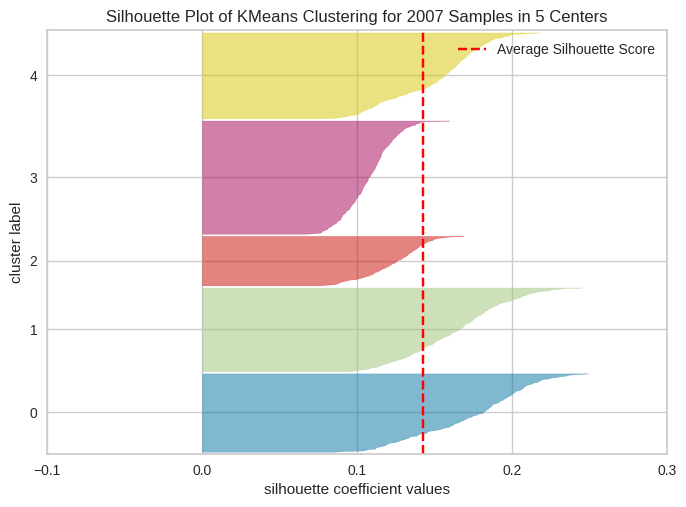

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 2007 Samples in 5 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [ ]:
from yellowbrick.cluster import SilhouetteVisualizer
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=5, random_state=42)
visualizer = SilhouetteVisualizer(kmeans, colors="yellowbrick")
visualizer.fit(pet_scaled)
print("The average silhouette score is:", visualizer.silhouette_score_)
visualizer.show()

A Silhouette Score output of 0.14 which is closer to 0 indicates suboptimal clustering performance. This score is low, suggesting that the clusters are not well-defined and that there is significant overlap between them, or that the clustering is not very strong.


The silhouette plot visually confirms that the clustering at
K=5 does not result in well-separated groups. The average silhouette score line (marked in red) is low, and there are many points close to or below this line, signifying poor assignment quality for these clusters.

Although the elbow method suggested that 5 clusters , the silhouette plot highlights that this choice does not necessarily lead to well-defined or meaningful clusters.

The visual results show that it's important to use different ways to check clustering results to make sure the chosen number of clusters actually fits the data well.

**Visualizing the Clusters:**

In [ ]:
optimal_k = 5  # Replace this with the chosen number of clusters
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
df2['Cluster'] = kmeans.fit_predict(scaled_features)
print(df2.groupby('Cluster').mean())

          PetType  AgeMonths      Size  WeightKg  Vaccinated  HealthCondition  \
Cluster                                                                         
0        1.540470   2.522193  1.036554  0.488611    0.738903         0.174935   
1        1.410758   2.557457  1.012225  0.523473    0.679707         0.215159   
2        1.549587   2.524793  1.033058  0.487624    0.000000         0.152893   
3        1.500904   2.576854  1.000000  0.514328    1.000000         0.197107   
4        1.561905   2.490476  1.014286  0.508587    0.697619         0.221429   

         TimeInShelterDays  AdoptionFee  PreviousOwner  AdoptionLikelihood  \
Cluster                                                                      
0                 1.086162     0.523104       0.308094            0.326371   
1                 1.095355     0.483309       0.273839            0.347188   
2                 1.074380     0.481111       0.334711            0.140496   
3                 1.132007     0.512261   

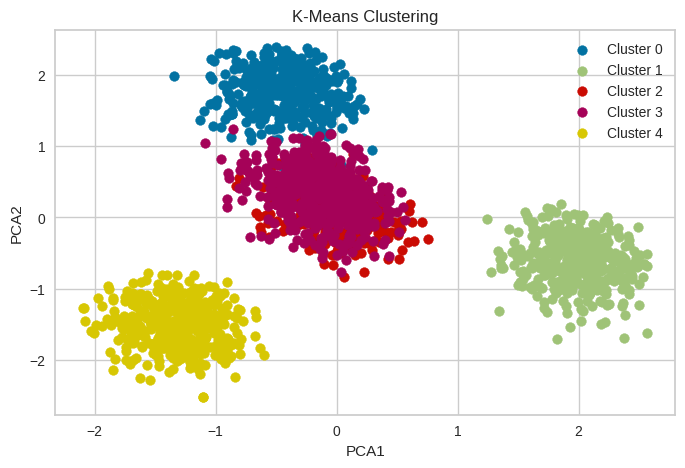

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
pca_features = pca.fit_transform(scaled_features)
df2['PCA1'] = pca_features[:, 0]
df2['PCA2'] = pca_features[:, 1]

plt.figure(figsize=(8, 5))
for cluster in range(optimal_k):
    cluster_data = df2[df2['Cluster'] == cluster]
    plt.scatter(cluster_data['PCA1'], cluster_data['PCA2'], label=f'Cluster {cluster}')

plt.title("K-Means Clustering")
plt.xlabel("PCA1")
plt.ylabel("PCA2")
plt.legend()
plt.show()


The plot shows five well-separated clusters (clusters 0 to 4) in the two-dimensional space "PCA", indicating that the K-means algorithm successfully identified distinct groupings within the data.

As we mentioned before in the silhouette score result that might be an overlapping, also from the plot above we can see that Clusters like Cluster 3 and Cluster 2 appear more densely packed, suggesting that data points in these clusters may have more similar feature values. In contrast, Cluster 1 appears somewhat more spread out, indicating a bit more variability within that group.
( or might be due to the dimensions ).

Cluster 0, Cluster 2, and Cluster 3 are relatively close to each other compared to Cluster 1 and Cluster 4, which are more isolated. This proximity could imply that the clusters close together share some characteristics, while the isolated clusters represent unique groups.

These clusters could represent distinct groups based on features like age, size, time in shelter, and other features.
The isolated cluster (Cluster 1) may represent a unique subset of pets that have distinct characteristics (such as larger or smaller values in a key feature), which separate them from the rest.

**In summary,** the K-means clustering has effectively grouped the data into distinct clusters with meaningful separations, and the visualization using PCA provides a clear view of these groupings. The relatively isolated clusters indicate unique data groups, while closely located clusters may share **overlapping characteristics.**

#  Clustering (using other features combination for better results)

Scaled features
Selecting the features for clustering and normalize them using StandardScaler

In [ ]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

In [ ]:
features = df2[['AgeMonths',  'WeightKg']]
scaler = StandardScaler()
scaled_features = scaler.fit_transform(features)
pet_scaled = pd.DataFrame(scaled_features , columns=features.columns)
print("Scaled DataFrame:")
print(pet_scaled)

Scaled DataFrame:
      AgeMonths  WeightKg
0     -1.084264 -1.281098
1      1.030525  0.045756
2     -1.084264 -1.637043
3      1.030525 -1.485328
4     -1.084264  0.575608
...         ...       ...
2002   1.030525  1.361243
2003  -1.084264 -1.318671
2004   1.030525 -1.675202
2005   1.735454  0.631278
2006  -1.084264  0.337992

[2007 rows x 2 columns]


**K-Means Clustering:**

Choosing the number of clusters (k).
Using the Elbow Method to identify the optimal number of clusters by plotting inertia for different **K** values

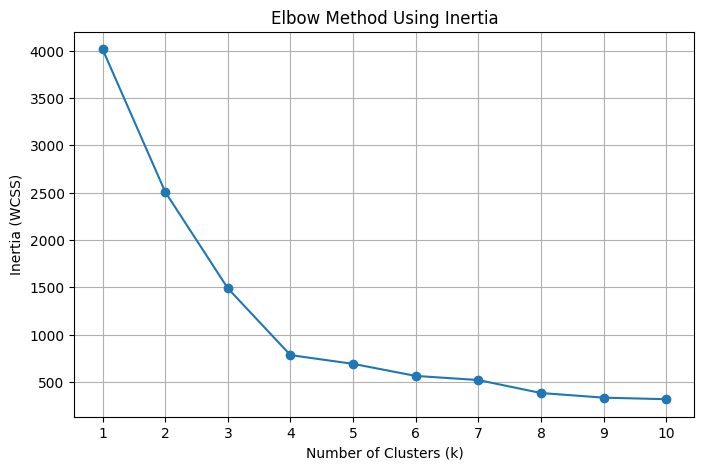

In [ ]:
inertia_values = []
k_range = range(1, 11)  # Test for k from 1 to 10

for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(scaled_features)  # Use your normalized features
    inertia_values.append(kmeans.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(k_range, inertia_values, marker='o')
plt.title("Elbow Method Using Inertia")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Inertia (WCSS)")
plt.xticks(k_range)
plt.grid()
plt.show()

comparing and discussing different K numbers

From the Elbow Method plot, we can observe that : As K increases from 1 to 10, the inertia decreases, indicating that the clusters are becoming more compact,since increasing K allows more centroids to reduce the sum of squared distances.

**k = 2 (First significant drop)**
Inertia drops significantly between k=1 and k=2, indicating that adding a second cluster provides a considerable improvement in clustering the data.

**k = 4 (Elbow point)**
The inertia begins to level off after k=4. we can considered this as the "elbow" point, where increasing k beyond 4 yields diminishing returns in terms of reducing inertia.

**k = 10 (Minimal Decrease in Inertia)**
Beyond k=4, the inertia decreases only slightly for larger values of k, as seen at k=10. This indicates that the additional clusters don’t improve the clustering much further.k=10, the clustering is overly fine-grained.Each cluster would likely have a small number of members,rather than truly meaningful groups.

**in conclusion** the optimal K number will be the elbow point which is **k = 4** .

**comparing and discussing the results of  different K numbers of clusters using Silhouette evaluation method  **

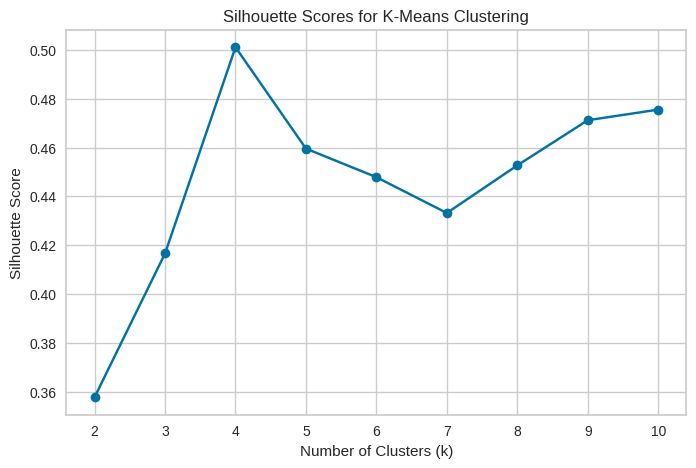

In [ ]:
from sklearn.metrics import silhouette_score

silhouette_scores = []
k_range = range(2, 11)  # Start from 2 clusters (k=1 is meaningless for silhouette)

for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(scaled_features)
    score = silhouette_score(scaled_features, labels)
    silhouette_scores.append(score)

plt.figure(figsize=(8, 5))
plt.plot(k_range, silhouette_scores, marker='o')
plt.title("Silhouette Scores for K-Means Clustering")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Silhouette Score")
plt.show()


**for K=2**

Silhouette Score: Approximately 0.36 (the lowest in the range).
A low silhouette score indicates that the clustering is poor,  because two clusters are insufficient to capture the natural structure of the data. Many data points are likely assigned to the wrong cluster, because 2 clusters may forces diverse data points into only two groups, oversimplifying the dataset.
It creates overly broad clusters, leading to low-quality groupings.


---


**for K=4 (the optimal k number):**

Silhouette Score: Approximately 0.51 (the highest value).
The best clustering performance in this range, indicating that clusters are well-separated and data points fit well within their groups. Data points within each cluster are relatively compact and distinct from those in other clusters.
**in Conclusion:**
k=4 is the optimal choice based on the silhouette score.


---


**for K=10:**

Silhouette Score: Approximately 0.46 (comparable to the scores for k=3 and k=5).
While the silhouette score suggests a reasonable clustering result, having ten clusters might introduce unnecessary complexity, clusters may be too fragmented, splitting naturally cohesive groups into smaller, less meaningful sub-groups.


**Validation & evaluation of optimal k number of clusters with Silhouette Score**

The average silhouette score is: 0.5010760695393801


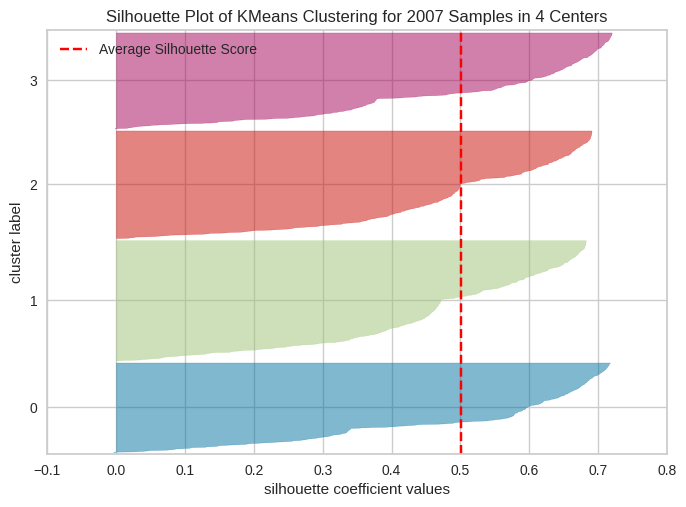

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 2007 Samples in 4 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [ ]:
from yellowbrick.cluster import SilhouetteVisualizer
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=4, random_state=42)
visualizer = SilhouetteVisualizer(kmeans, colors="yellowbrick")
visualizer.fit(pet_scaled)
print("The average silhouette score is:", visualizer.silhouette_score_)
visualizer.show()



At 0.5 (the highest silhouette score of k values),

 indicating the best balance between compactness and separation of clusters.
the clustering is:

Fairly compact: Points within the clusters are moderately close to each other.

Reasonably separated: Clusters are distinct but not entirely isolated, meaning some overlap might still occur.

A score of 0.5 suggests moderately well-defined clusters and distinct,
Clusters are distinguishable but not perfectly separated — pets of similar ages and weights could share overlapping characteristics.



The optimaal value of k is likely a good fit for the data.

**Visualizing the Clusters:**

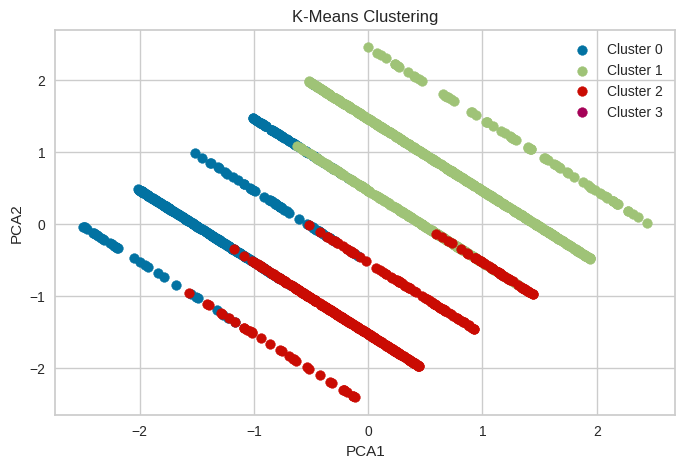

In [ ]:
from sklearn.decomposition import PCA
optimal_k = 4

pca = PCA(n_components=2)
pca_features = pca.fit_transform(scaled_features)
df['PCA1'] = pca_features[:, 0]
df['PCA2'] = pca_features[:, 1]

plt.figure(figsize=(8, 5))
for cluster in range(optimal_k):
    cluster_data = df[df['Cluster'] == cluster]
    plt.scatter(cluster_data['PCA1'], cluster_data['PCA2'], label=f'Cluster {cluster}')

plt.title("K-Means Clustering")
plt.xlabel("PCA1")
plt.ylabel("PCA2")
plt.legend()
plt.show()


There are four distinct clusters (labeled as Cluster 0, Cluster 1, Cluster 2, and Cluster 3), as determined by the
k=4 clustering.
The clusters appear to be well-separated in the PCA-reduced space. This indicates that the K-Means algorithm has successfully grouped similar data points into distinct clusters with minimal overlap in this lower-dimensional representation.

as we discussed in the silhouette score results and from the clustering visualisation plot above we can see that there is an overlapping. the solution might be adding more features or try other features combinations . Absolutely we tried both of this solutions but it results with a minimum silhouette score than the current features selected.

 including additional features may cause cluster boundaries to become less distinct because unrelated features dilute the meaningful patterns in the data. This leads to decreasing intra-cluster cohesion, clusters overlapping due to increased dimensionality.
 **By focusing on "AgeMonths" and "WeightKg", we are limiting the clustering to features that maximize separability, and provide Simpler model, better-defined clusters, and a Silhouette Score of 0.5, indicating moderate quality.**
 These features likely show a clear separation in the dataset, minimizing ambiguity between clusters.



---


**Analysing cluster characteristics :**


*   Cluster 0 might represent younger, smaller pets.
*   Cluster 1 might represent medium-sized pets at a particular stage of development.
*  Cluster 2 and Cluster 3 might group older or heavier pets.